<a href="https://colab.research.google.com/github/Shudipta99/Covid19-detection-with-cnn/blob/main/Covid_19.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
file1 = r'/content/gdrive/MyDrive/CovidDataset_latest.zip'


In [ ]:
#!wget http://cb.lk/covid_19

In [ ]:
!unzip /content/gdrive/MyDrive/CovidDataset_latest.zip #covid_19  /content/gdrive/MyDrive/CovidDataset-20220206T112216Z-001.zip.rar

Archive:  /content/gdrive/MyDrive/CovidDataset_latest.zip
   creating: CovidDataset/
   creating: CovidDataset/Train/
   creating: CovidDataset/Train/Covid/
  inflating: CovidDataset/Train/Covid/000001-17.jpg  
  inflating: CovidDataset/Train/Covid/000001-18.jpg  
  inflating: CovidDataset/Train/Covid/000001-19.jpg  
  inflating: CovidDataset/Train/Covid/000001-20.jpg  
  inflating: CovidDataset/Train/Covid/000001-24.jpg  
  inflating: CovidDataset/Train/Covid/000001-266.jpg  
  inflating: CovidDataset/Train/Covid/000001-27.jpg  
  inflating: CovidDataset/Train/Covid/000001-272.jpg  
  inflating: CovidDataset/Train/Covid/000002-1.jpg  
  inflating: CovidDataset/Train/Covid/000002-11-a.jpg  
  inflating: CovidDataset/Train/Covid/000002-11-b.jpg  
  inflating: CovidDataset/Train/Covid/000002-14.jpg  
  inflating: CovidDataset/Train/Covid/000002-16.jpg  
  inflating: CovidDataset/Train/Covid/000002-19-a.jpg  
  inflating: CovidDataset/Train/Covid/000002-19-b.jpg  
  inflating: CovidDatase

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
TRAIN_PATH="CovidDataset/Train"
VAL_PATH="CovidDataset/Test"

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import keras
from keras.layers import *
from keras.models import *
from keras.preprocessing import image

In [ ]:
#CNN Based Model in Keras
#Here we added 4 covolutional layers
model=Sequential()
model.add(Conv2D(32,kernel_size=(3,3),activation='relu',input_shape=(224,224,3)))
model.add(Conv2D(64,(3,3),activation='relu'))
model.add(MaxPooling2D(pool_size=(2,2)))
model.add(Dropout(0.25))

model.add(Conv2D(64,(3,3),activation='relu'))
model.add(MaxPooling2D(pool_size=(2,2)))
model.add(Dropout(0.25))

model.add(Conv2D(128,(3,3),activation='relu'))
model.add(MaxPooling2D(pool_size=(2,2)))
model.add(Dropout(0.25))

#conf layer
model.add(Flatten())
model.add(Dense(64,activation='relu'))
model.add(Dropout(0.5))
model.add(Dense(1,activation='sigmoid'))


#compile our model now
model.compile(loss=keras.losses.binary_crossentropy,optimizer='adam',metrics=['accuracy'])




In [ ]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 222, 222, 32)      896       
                                                                 
 conv2d_1 (Conv2D)           (None, 220, 220, 64)      18496     
                                                                 
 max_pooling2d (MaxPooling2D  (None, 110, 110, 64)     0         
 )                                                               
                                                                 
 dropout (Dropout)           (None, 110, 110, 64)      0         
                                                                 
 conv2d_2 (Conv2D)           (None, 108, 108, 64)      36928     
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 54, 54, 64)       0         
 2D)                                                    

In [ ]:
#Train the model from scratch
train_datagen= image.ImageDataGenerator(
    rescale= 1./255,
    zoom_range=0.2,
    horizontal_flip=True,
)  

test_dataset = image.ImageDataGenerator(rescale=1./255)


In [ ]:
train_generator = train_datagen.flow_from_directory(
    'CovidDataset/Train',
    target_size=(224,224),
    batch_size = 32,
    class_mode = 'binary')

Found 1360 images belonging to 2 classes.


In [ ]:
train_generator.class_indices

{'Covid': 0, 'Normal': 1}

In [ ]:
validation_generator=test_dataset.flow_from_directory(
    'CovidDataset/Val',
    target_size=(224,224),
    batch_size = 32,
    class_mode = 'binary')



Found 500 images belonging to 2 classes.


In [ ]:
 import os
log_dir = os.path.join(
    "logs",
    "fit"
)

tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1)

hist = model.fit(train_generator,
                    steps_per_epoch=5,
                    epochs=50,
                    validation_data=validation_generator,
                    validation_steps=2, callbacks=[tensorboard_callback])

Epoch 1/50
5/5 [==============================] - 58s 13s/step - loss: 1.5997 - accuracy: 0.5764 - val_loss: 0.6908 - val_accuracy: 0.5312
Epoch 2/50
5/5 [==============================] - 60s 12s/step - loss: 0.6724 - accuracy: 0.5688 - val_loss: 0.7012 - val_accuracy: 0.4531
Epoch 3/50
5/5 [==============================] - 60s 12s/step - loss: 0.7114 - accuracy: 0.5063 - val_loss: 0.6868 - val_accuracy: 0.7188
Epoch 4/50
5/5 [==============================] - 59s 12s/step - loss: 0.6702 - accuracy: 0.6562 - val_loss: 0.6891 - val_accuracy: 0.4062
Epoch 5/50
5/5 [==============================] - 59s 12s/step - loss: 0.6431 - accuracy: 0.6125 - val_loss: 0.6393 - val_accuracy: 0.6406
Epoch 6/50
5/5 [==============================] - 57s 11s/step - loss: 0.6006 - accuracy: 0.6750 - val_loss: 0.5584 - val_accuracy: 0.8906
Epoch 7/50
5/5 [==============================] - 60s 12s/step - loss: 0.3914 - accuracy: 0.8250 - val_loss: 0.3025 - val_accuracy: 0.9375
Epoch 8/50
5/5 [===========

In [ ]:
%load_ext tensorboard

%tensorboard --logdir logs/fit

<IPython.core.display.Javascript object>

# Loss is very less


In [ ]:
model.save('model_adv.h5')

In [ ]:
model.evaluate(train_generator)

43/43 [==============================] - 138s 3s/step - loss: 0.0843 - accuracy: 0.9743


[0.0843096673488617, 0.9742646813392639]

In [ ]:
model.evaluate(validation_generator)

# Test Images

In [ ]:
model= load_model('model_adv.h5')

In [ ]:
import os

In [ ]:
train_generator.class_indices

In [ ]:
y_actual=[]
y_test=[]

In [ ]:

import numpy as np

for i in os.listdir("./CovidDataset/Val/Normal/"):
  img=image.load_img("./CovidDataset/Val/Normal/"+i, target_size=(224,224))
  img=image.img_to_array(img)
  img=np.expand_dims(img, axis=0)
  p_value=model.predict(img)
  p=np.argmax(p_value, axis=1)
  y_test.append(p)
  y_actual.append(1)

In [ ]:
for i in os.listdir("./CovidDataset/Val/Covid/"):
  img=image.load_img("./CovidDataset/Val/Covid/"+i, target_size=(224,224))
  img=image.img_to_array(img)
  img=np.expand_dims(img, axis=0)
  #p=model.predict_classes(img)
  p_value=model.predict(img)
  p=np.argmax(p_value, axis=1)  
  y_test.append(p)
  y_actual.append(0)

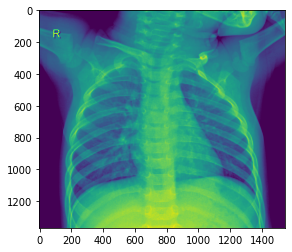

Predicted value
NORMAL2-IM-0642-0001.jpeg
Actual value


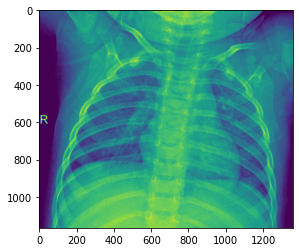

Predicted value
NORMAL2-IM-0852-0001.jpeg
Actual value


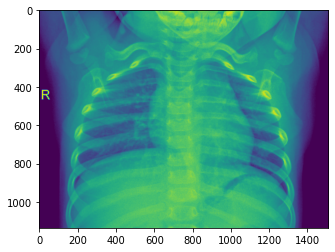

Predicted value
NORMAL2-IM-0640-0001.jpeg
Actual value


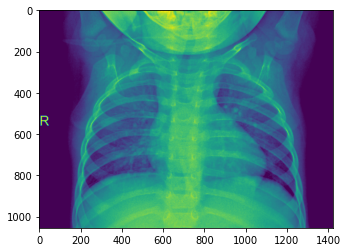

Predicted value
NORMAL2-IM-0880-0001.jpeg
Actual value


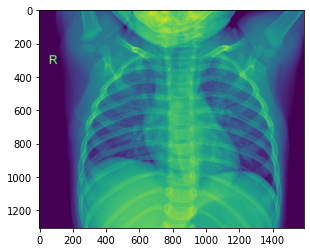

Predicted value
NORMAL2-IM-0857-0001.jpeg
Actual value


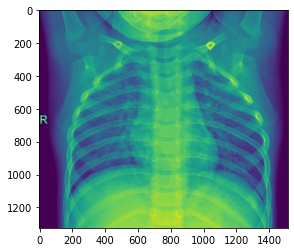

Predicted value
NORMAL2-IM-0686-0001.jpeg
Actual value


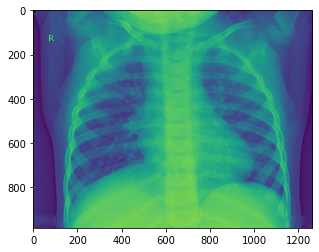

Predicted value
NORMAL2-IM-0765-0001.jpeg
Actual value


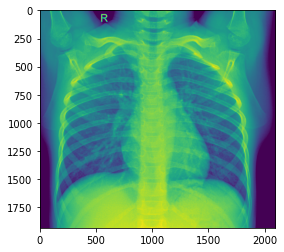

Predicted value
NORMAL2-IM-0663-0001.jpeg
Actual value


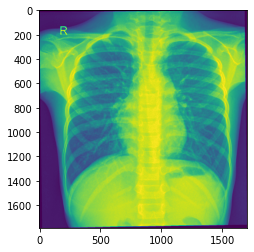

Predicted value
NORMAL2-IM-0780-0001.jpeg
Actual value


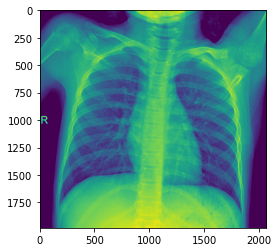

Predicted value
NORMAL2-IM-0547-0001.jpeg
Actual value


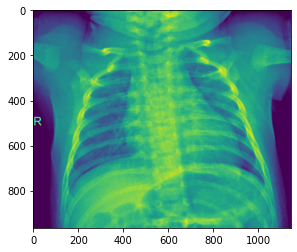

Predicted value
NORMAL2-IM-0829-0001.jpeg
Actual value


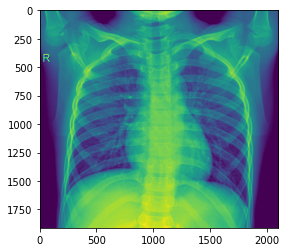

Predicted value
NORMAL2-IM-0875-0001.jpeg
Actual value


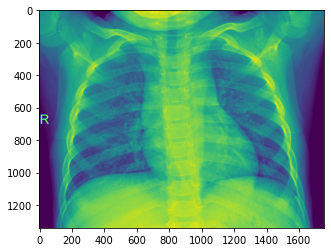

Predicted value
NORMAL2-IM-0812-0001.jpeg
Actual value


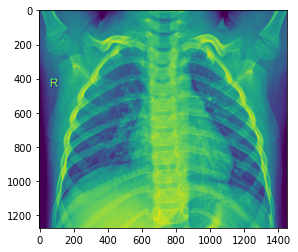

Predicted value
NORMAL2-IM-0918-0001.jpeg
Actual value


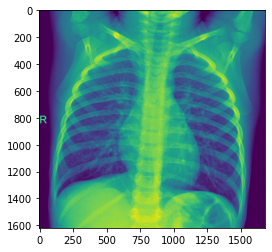

Predicted value
NORMAL2-IM-0647-0001.jpeg
Actual value


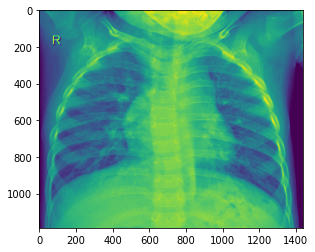

Predicted value
NORMAL2-IM-0659-0001.jpeg
Actual value


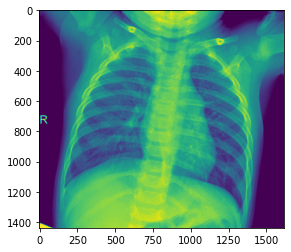

Predicted value
NORMAL2-IM-0820-0001.jpeg
Actual value


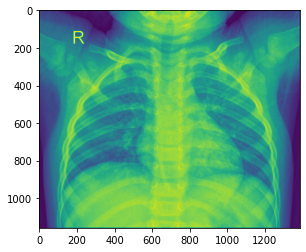

Predicted value
NORMAL2-IM-0830-0001.jpeg
Actual value


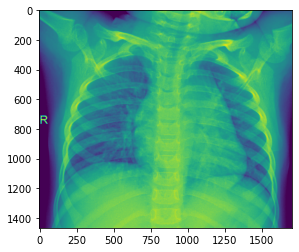

Predicted value
NORMAL2-IM-0843-0001.jpeg
Actual value


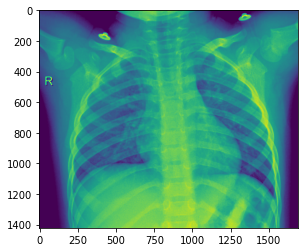

Predicted value
NORMAL2-IM-0576-0001.jpeg
Actual value


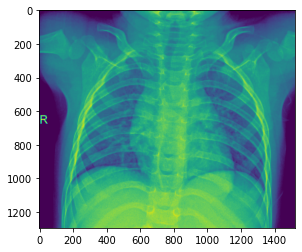

Predicted value
NORMAL2-IM-0657-0001.jpeg
Actual value


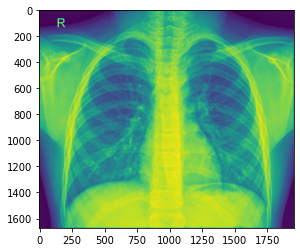

Predicted value
NORMAL2-IM-0651-0001.jpeg
Actual value


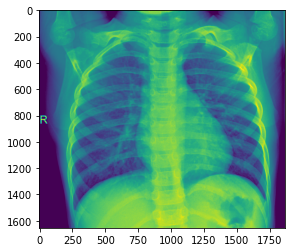

Predicted value
NORMAL2-IM-0577-0001.jpeg
Actual value


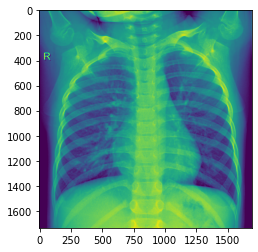

Predicted value
NORMAL2-IM-0669-0001.jpeg
Actual value


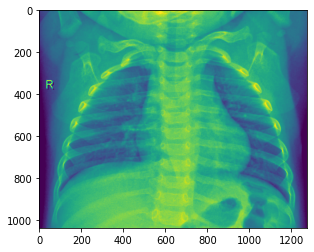

Predicted value
NORMAL2-IM-0915-0001.jpeg
Actual value


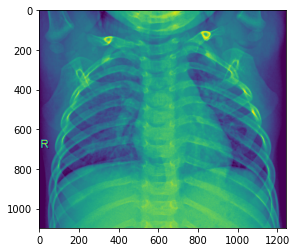

Predicted value
NORMAL2-IM-0689-0001.jpeg
Actual value


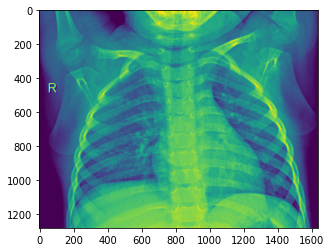

Predicted value
NORMAL2-IM-0810-0001.jpeg
Actual value


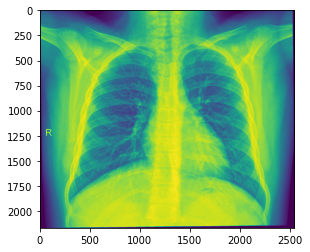

Predicted value
NORMAL2-IM-0904-0001.jpeg
Actual value


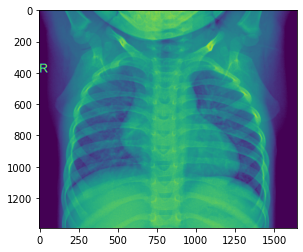

Predicted value
NORMAL2-IM-0804-0001.jpeg
Actual value


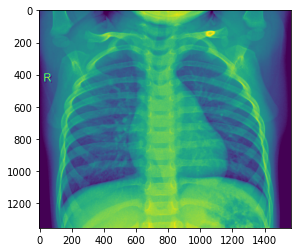

Predicted value
NORMAL2-IM-0847-0001.jpeg
Actual value


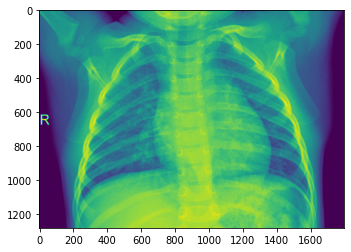

Predicted value
NORMAL2-IM-0819-0001.jpeg
Actual value


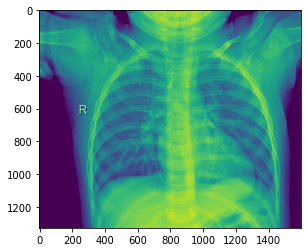

Predicted value
NORMAL2-IM-0630-0001.jpeg
Actual value


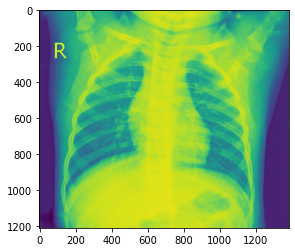

Predicted value
NORMAL2-IM-0707-0001.jpeg
Actual value


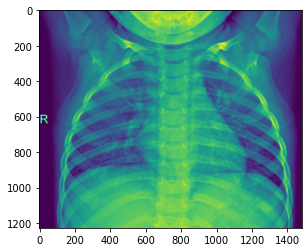

Predicted value
NORMAL2-IM-0870-0001.jpeg
Actual value


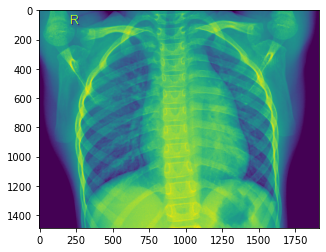

Predicted value
NORMAL2-IM-0579-0001.jpeg
Actual value


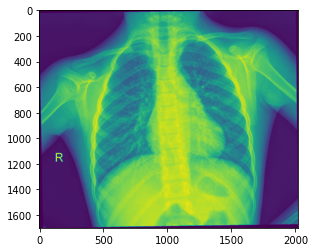

Predicted value
NORMAL2-IM-0693-0001.jpeg
Actual value


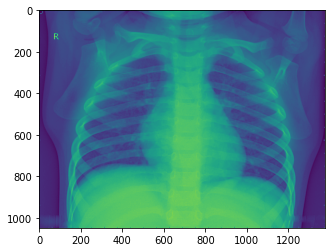

Predicted value
NORMAL2-IM-0772-0001.jpeg
Actual value


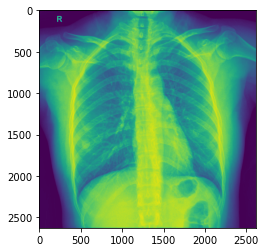

Predicted value
NORMAL2-IM-0602-0001.jpeg
Actual value


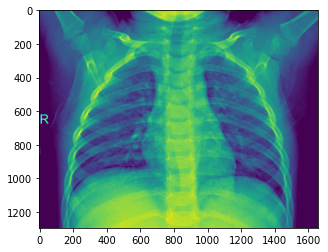

Predicted value
NORMAL2-IM-0842-0001.jpeg
Actual value


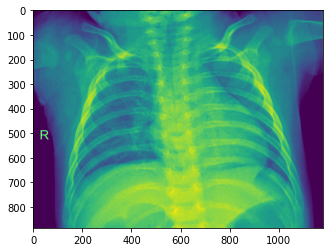

Predicted value
NORMAL2-IM-0554-0001.jpeg
Actual value


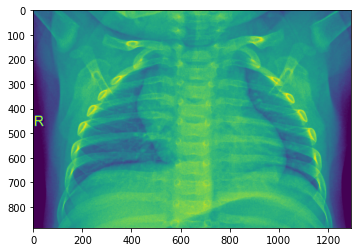

Predicted value
NORMAL2-IM-0893-0001.jpeg
Actual value


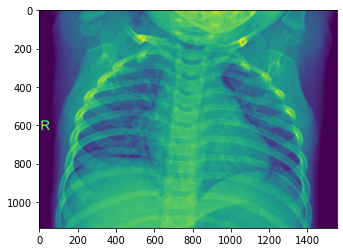

Predicted value
NORMAL2-IM-0796-0001.jpeg
Actual value


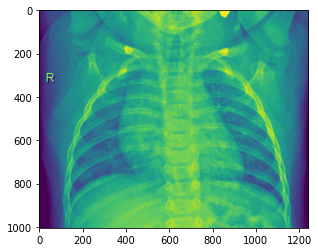

Predicted value
NORMAL2-IM-0912-0001.jpeg
Actual value


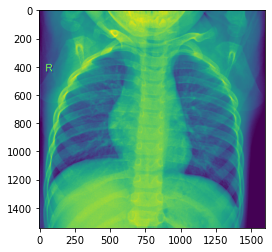

Predicted value
NORMAL2-IM-0668-0001.jpeg
Actual value


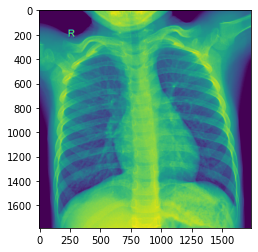

Predicted value
NORMAL2-IM-0620-0001.jpeg
Actual value


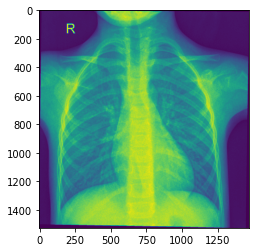

Predicted value
NORMAL2-IM-0600-0001.jpeg
Actual value


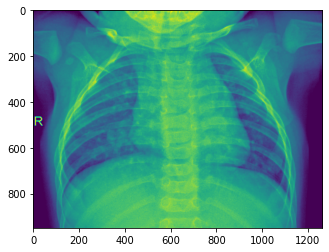

Predicted value
NORMAL2-IM-0660-0001.jpeg
Actual value


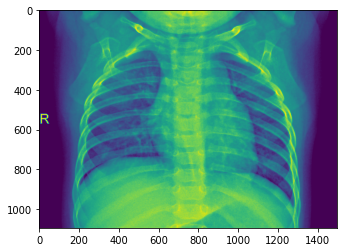

Predicted value
NORMAL2-IM-0887-0001.jpeg
Actual value


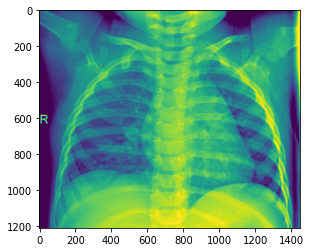

Predicted value
NORMAL2-IM-0592-0001.jpeg
Actual value


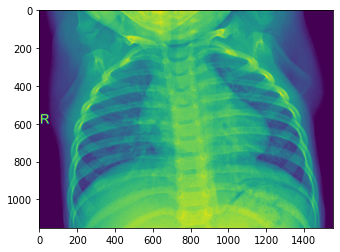

Predicted value
NORMAL2-IM-0853-0001.jpeg
Actual value


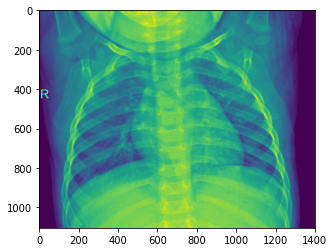

Predicted value
NORMAL2-IM-0908-0001.jpeg
Actual value


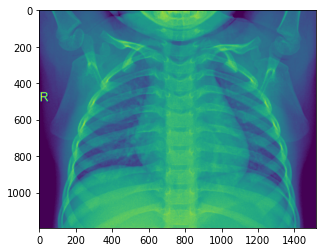

Predicted value
NORMAL2-IM-0649-0001.jpeg
Actual value


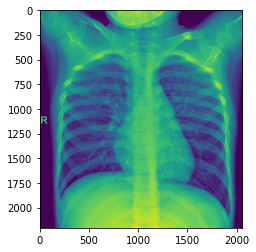

Predicted value
NORMAL2-IM-0555-0001-0001.jpeg
Actual value


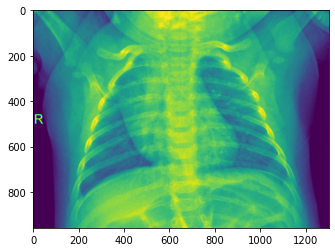

Predicted value
NORMAL2-IM-0555-0001.jpeg
Actual value


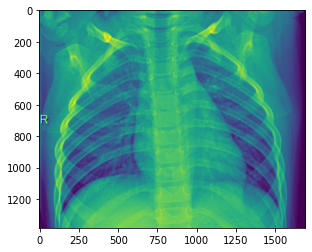

Predicted value
NORMAL2-IM-0617-0001.jpeg
Actual value


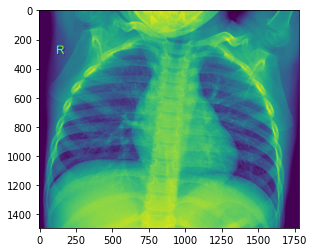

Predicted value
NORMAL2-IM-0682-0001.jpeg
Actual value


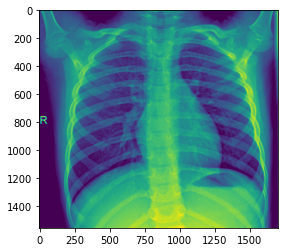

Predicted value
NORMAL2-IM-0860-0001.jpeg
Actual value


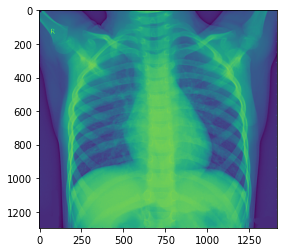

Predicted value
NORMAL2-IM-0744-0001.jpeg
Actual value


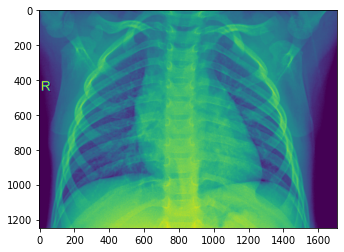

Predicted value
NORMAL2-IM-0553-0001.jpeg
Actual value


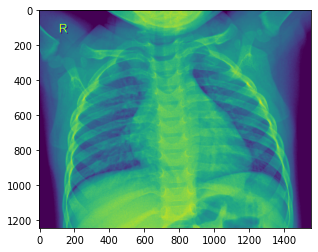

Predicted value
NORMAL2-IM-0698-0001.jpeg
Actual value


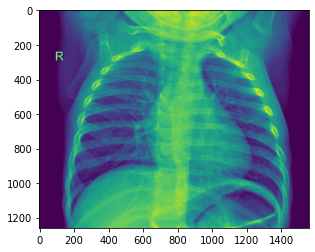

Predicted value
NORMAL2-IM-0858-0001.jpeg
Actual value


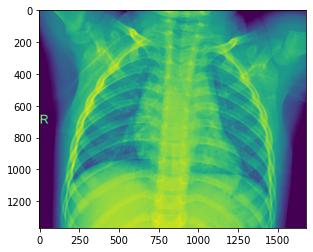

Predicted value
NORMAL2-IM-0811-0001.jpeg
Actual value


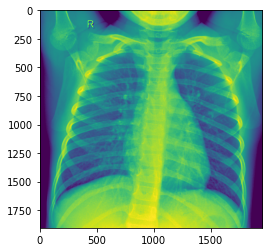

Predicted value
NORMAL2-IM-0909-0001.jpeg
Actual value


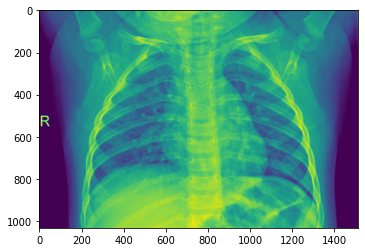

Predicted value
NORMAL2-IM-0848-0001.jpeg
Actual value


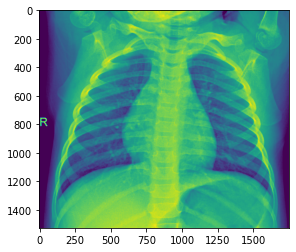

Predicted value
NORMAL2-IM-0572-0001.jpeg
Actual value


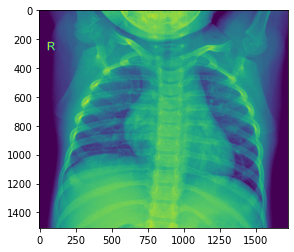

Predicted value
NORMAL2-IM-0825-0001.jpeg
Actual value


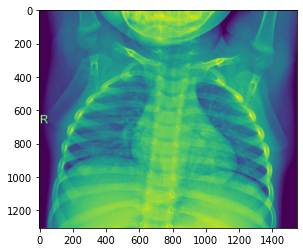

Predicted value
NORMAL2-IM-0905-0001.jpeg
Actual value


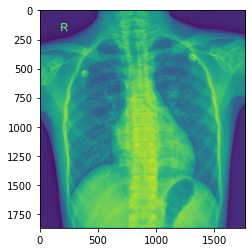

Predicted value
NORMAL2-IM-0559-0001.jpeg
Actual value


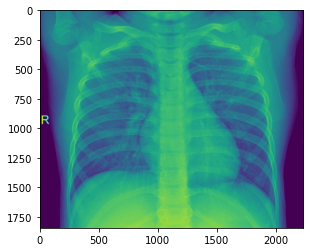

Predicted value
NORMAL2-IM-0603-0001.jpeg
Actual value


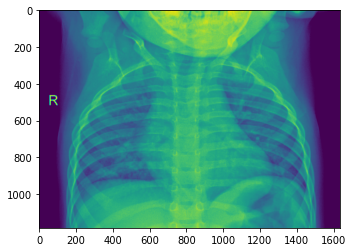

Predicted value
NORMAL2-IM-0678-0001.jpeg
Actual value


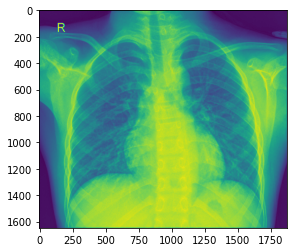

Predicted value
NORMAL2-IM-0664-0001.jpeg
Actual value


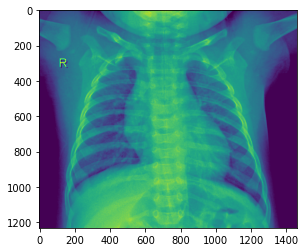

Predicted value
NORMAL2-IM-0675-0001.jpeg
Actual value


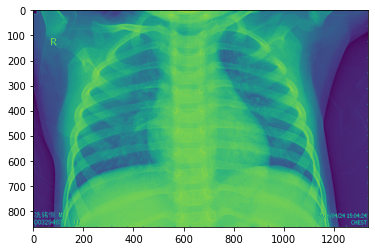

Predicted value
NORMAL2-IM-0611-0001.jpeg
Actual value


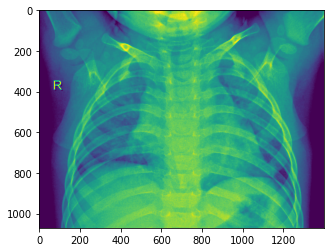

Predicted value
NORMAL2-IM-0635-0001.jpeg
Actual value


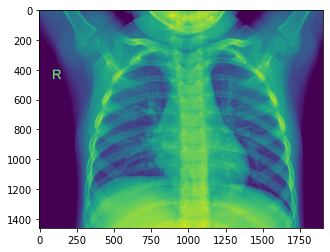

Predicted value
NORMAL2-IM-0822-0001.jpeg
Actual value


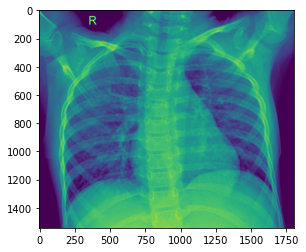

Predicted value
NORMAL2-IM-0623-0001.jpeg
Actual value


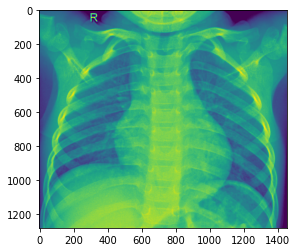

Predicted value
NORMAL2-IM-0616-0001.jpeg
Actual value


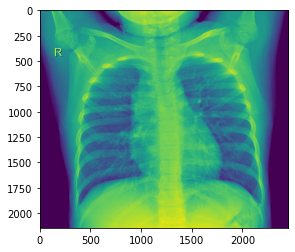

Predicted value
NORMAL2-IM-0888-0001.jpeg
Actual value


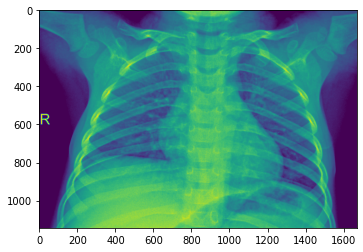

Predicted value
NORMAL2-IM-0654-0001.jpeg
Actual value


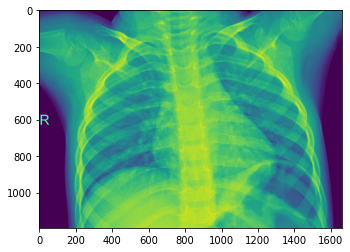

Predicted value
NORMAL2-IM-0854-0001.jpeg
Actual value


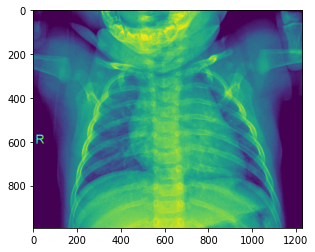

Predicted value
NORMAL2-IM-0824-0001.jpeg
Actual value


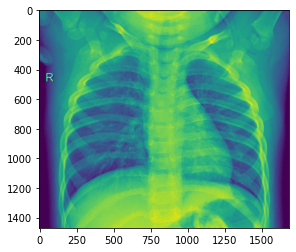

Predicted value
NORMAL2-IM-0575-0001.jpeg
Actual value


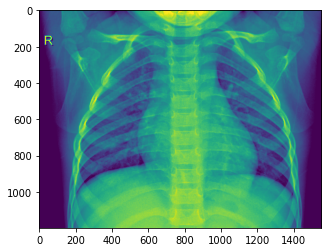

Predicted value
NORMAL2-IM-0564-0001.jpeg
Actual value


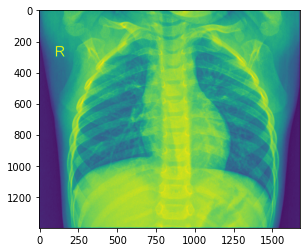

Predicted value
NORMAL2-IM-0897-0001.jpeg
Actual value


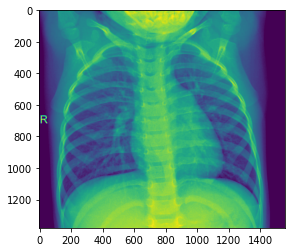

Predicted value
NORMAL2-IM-0629-0001.jpeg
Actual value


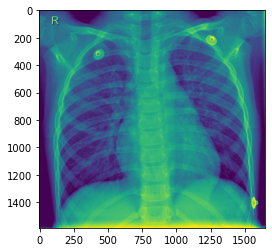

Predicted value
NORMAL2-IM-0827-0001.jpeg
Actual value


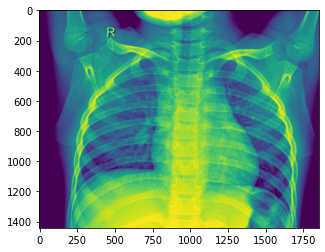

Predicted value
NORMAL2-IM-0594-0001.jpeg
Actual value


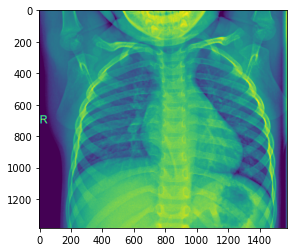

Predicted value
NORMAL2-IM-0672-0001.jpeg
Actual value


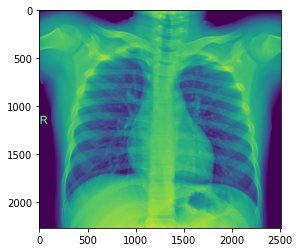

Predicted value
NORMAL2-IM-0702-0001.jpeg
Actual value


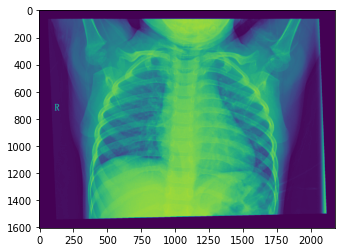

Predicted value
NORMAL2-IM-0793-0001.jpeg
Actual value


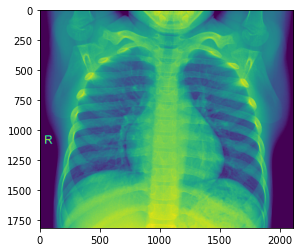

Predicted value
NORMAL2-IM-0622-0001.jpeg
Actual value


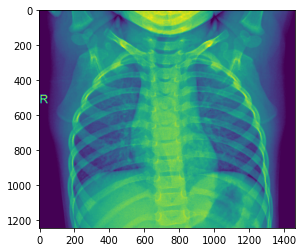

Predicted value
NORMAL2-IM-0648-0001.jpeg
Actual value


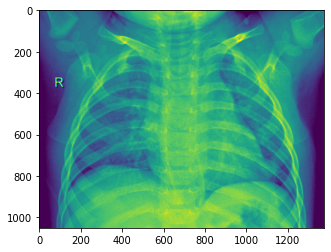

Predicted value
NORMAL2-IM-0636-0001.jpeg
Actual value


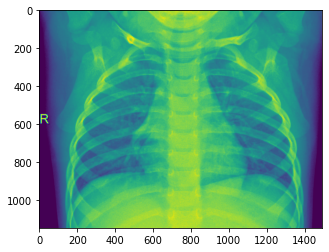

Predicted value
NORMAL2-IM-0917-0001.jpeg
Actual value


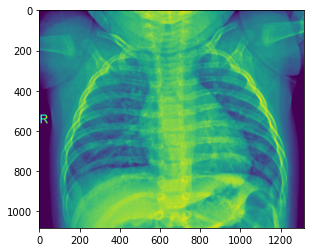

Predicted value
NORMAL2-IM-0595-0001.jpeg
Actual value


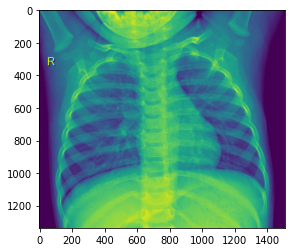

Predicted value
NORMAL2-IM-0806-0001.jpeg
Actual value


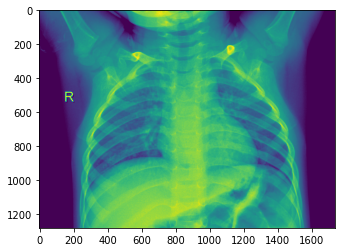

Predicted value
NORMAL2-IM-0803-0001.jpeg
Actual value


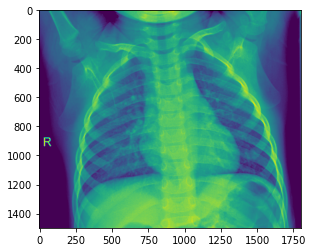

Predicted value
NORMAL2-IM-0833-0001.jpeg
Actual value


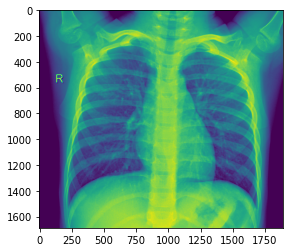

Predicted value
NORMAL2-IM-0578-0001.jpeg
Actual value


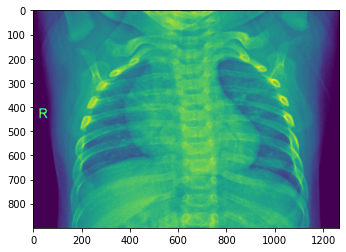

Predicted value
NORMAL2-IM-0885-0001.jpeg
Actual value


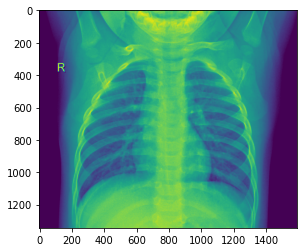

Predicted value
NORMAL2-IM-0680-0001.jpeg
Actual value


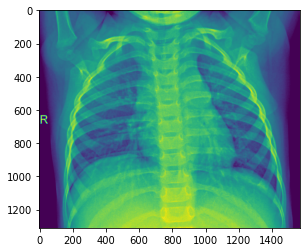

Predicted value
NORMAL2-IM-0862-0001.jpeg
Actual value


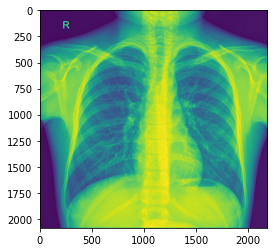

Predicted value
NORMAL2-IM-0865-0001.jpeg
Actual value


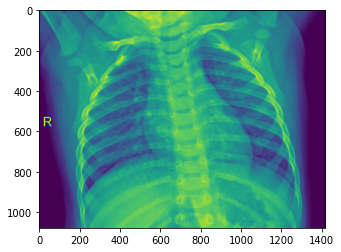

Predicted value
NORMAL2-IM-0898-0001.jpeg
Actual value


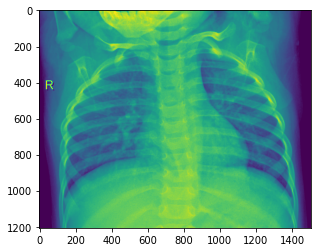

Predicted value
NORMAL2-IM-0587-0001.jpeg
Actual value


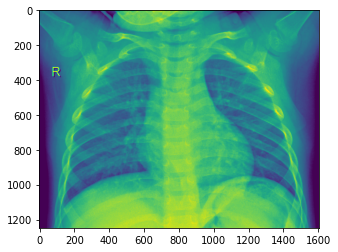

Predicted value
NORMAL2-IM-0637-0001.jpeg
Actual value


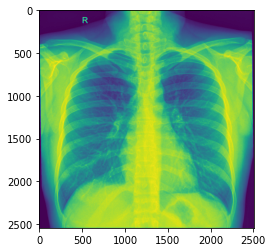

Predicted value
NORMAL2-IM-0774-0001.jpeg
Actual value


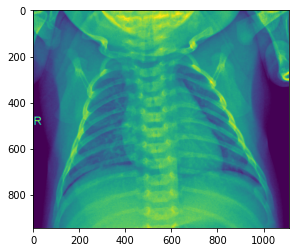

Predicted value
NORMAL2-IM-0558-0001.jpeg
Actual value


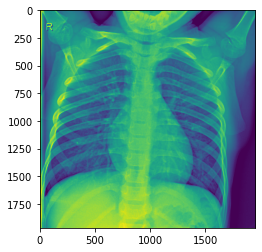

Predicted value
NORMAL2-IM-0846-0001.jpeg
Actual value


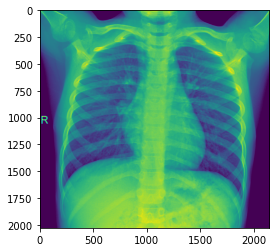

Predicted value
NORMAL2-IM-0661-0001.jpeg
Actual value


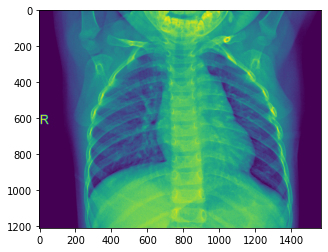

Predicted value
NORMAL2-IM-0667-0001.jpeg
Actual value


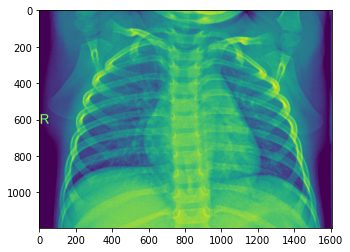

Predicted value
NORMAL2-IM-0566-0001.jpeg
Actual value


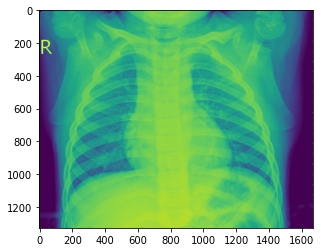

Predicted value
NORMAL2-IM-0730-0001.jpeg
Actual value


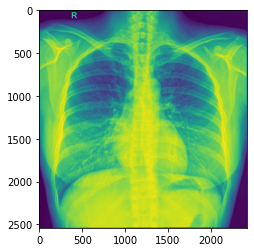

Predicted value
NORMAL2-IM-0587-0001-0002.jpeg
Actual value


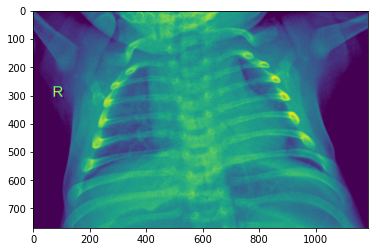

Predicted value
NORMAL2-IM-0665-0001.jpeg
Actual value


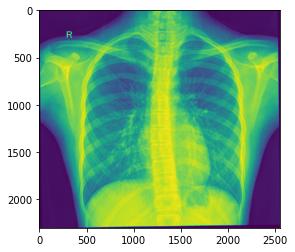

Predicted value
NORMAL2-IM-0828-0001.jpeg
Actual value


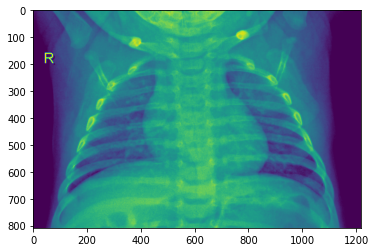

Predicted value
NORMAL2-IM-0588-0001.jpeg
Actual value


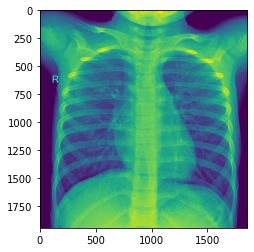

Predicted value
NORMAL2-IM-0609-0001.jpeg
Actual value


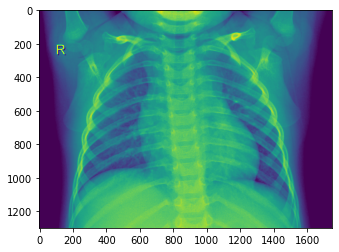

Predicted value
NORMAL2-IM-0874-0001.jpeg
Actual value


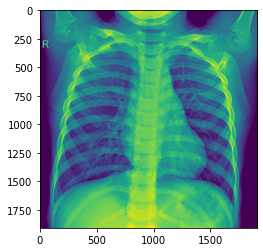

Predicted value
NORMAL2-IM-0601-0001.jpeg
Actual value


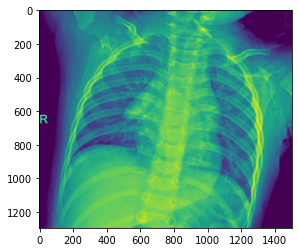

Predicted value
NORMAL2-IM-0695-0001.jpeg
Actual value


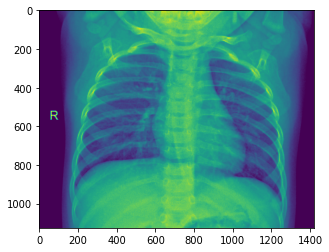

Predicted value
NORMAL2-IM-0652-0001.jpeg
Actual value


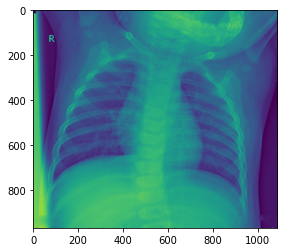

Predicted value
NORMAL2-IM-0753-0001.jpeg
Actual value


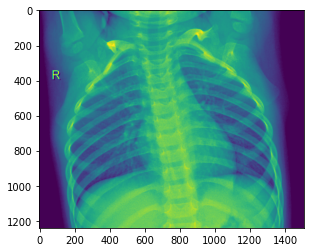

Predicted value
NORMAL2-IM-0913-0001.jpeg
Actual value


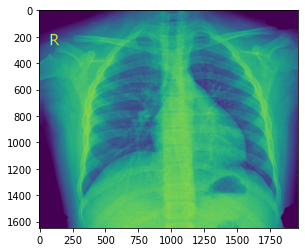

Predicted value
NORMAL2-IM-0705-0001.jpeg
Actual value


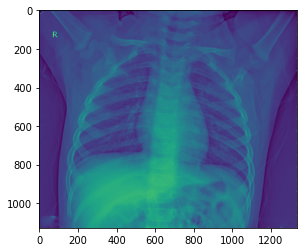

Predicted value
NORMAL2-IM-0771-0001.jpeg
Actual value


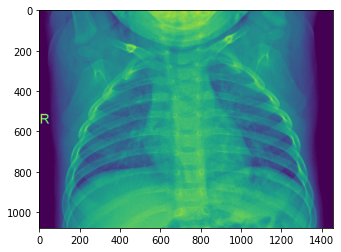

Predicted value
NORMAL2-IM-0879-0001.jpeg
Actual value


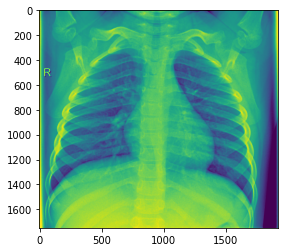

Predicted value
NORMAL2-IM-0666-0001.jpeg
Actual value


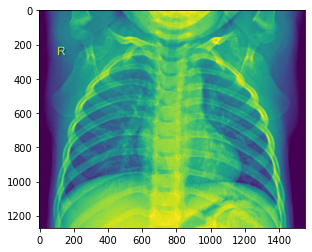

Predicted value
NORMAL2-IM-0900-0001.jpeg
Actual value


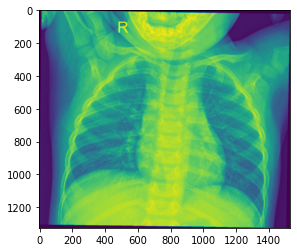

Predicted value
NORMAL2-IM-0650-0001.jpeg
Actual value


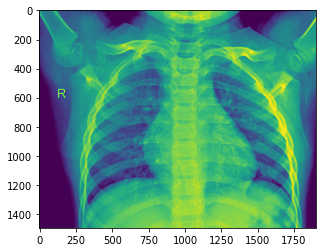

Predicted value
NORMAL2-IM-0643-0001.jpeg
Actual value


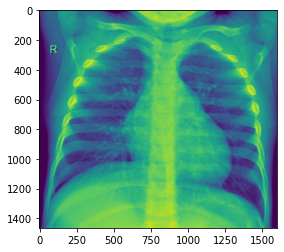

Predicted value
NORMAL2-IM-0881-0001.jpeg
Actual value


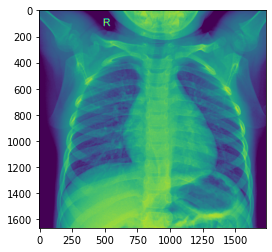

Predicted value
NORMAL2-IM-0896-0001.jpeg
Actual value


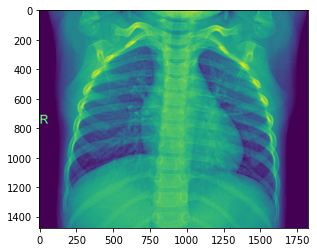

Predicted value
NORMAL2-IM-0626-0001.jpeg
Actual value


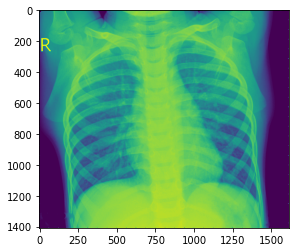

Predicted value
NORMAL2-IM-0719-0001.jpeg
Actual value


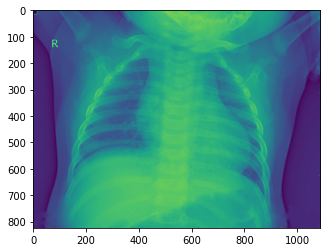

Predicted value
NORMAL2-IM-0725-0001.jpeg
Actual value


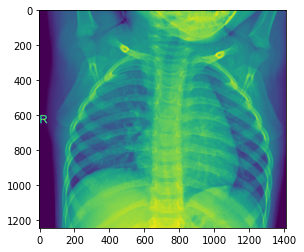

Predicted value
NORMAL2-IM-0543-0001.jpeg
Actual value


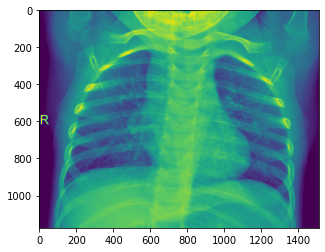

Predicted value
NORMAL2-IM-0645-0001.jpeg
Actual value


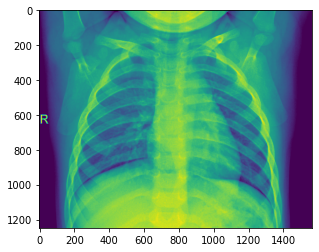

Predicted value
NORMAL2-IM-0837-0001.jpeg
Actual value


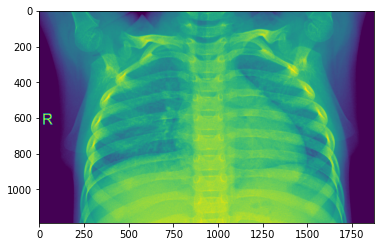

Predicted value
NORMAL2-IM-0876-0001.jpeg
Actual value


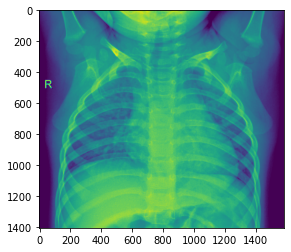

Predicted value
NORMAL2-IM-0877-0001.jpeg
Actual value


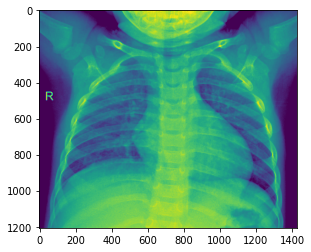

Predicted value
NORMAL2-IM-0832-0001-0002.jpeg
Actual value


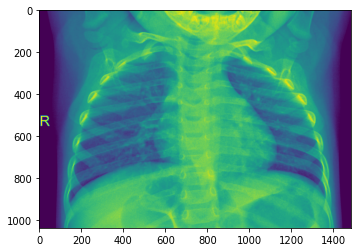

Predicted value
NORMAL2-IM-0599-0001.jpeg
Actual value


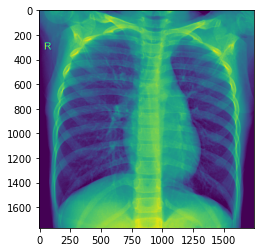

Predicted value
NORMAL2-IM-0776-0001.jpeg
Actual value


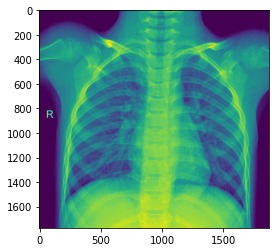

Predicted value
NORMAL2-IM-0700-0001.jpeg
Actual value


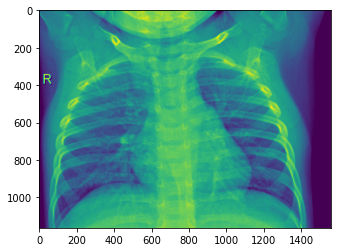

Predicted value
NORMAL2-IM-0851-0001-0001.jpeg
Actual value


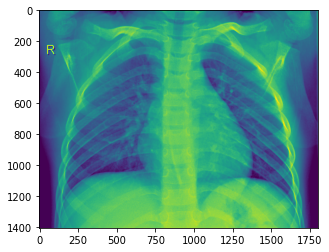

Predicted value
NORMAL2-IM-0655-0001.jpeg
Actual value


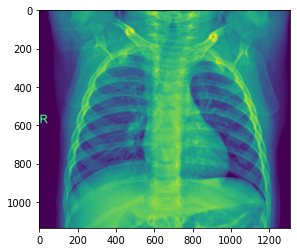

Predicted value
NORMAL2-IM-0775-0001.jpeg
Actual value


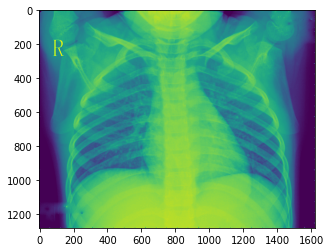

Predicted value
NORMAL2-IM-0790-0001.jpeg
Actual value


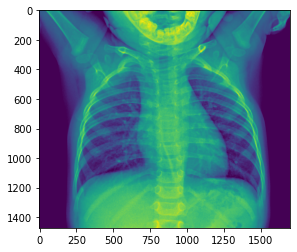

Predicted value
NORMAL2-IM-0845-0001.jpeg
Actual value


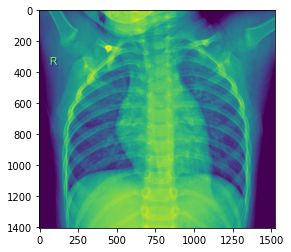

Predicted value
NORMAL2-IM-0777-0001.jpeg
Actual value


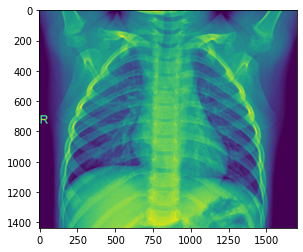

Predicted value
NORMAL2-IM-0604-0001.jpeg
Actual value


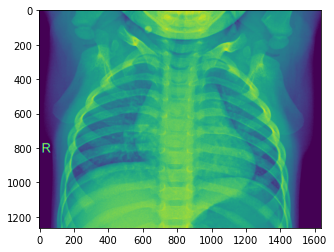

Predicted value
NORMAL2-IM-0552-0001.jpeg
Actual value


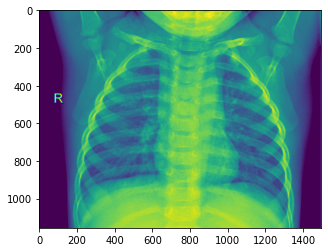

Predicted value
NORMAL2-IM-0903-0001.jpeg
Actual value


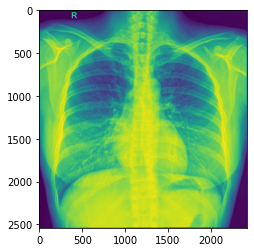

Predicted value
NORMAL2-IM-0587-0001-0001.jpeg
Actual value


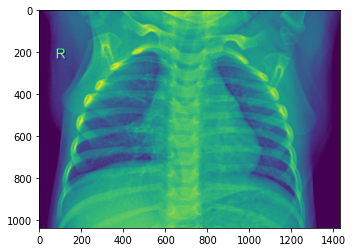

Predicted value
NORMAL2-IM-0895-0001.jpeg
Actual value


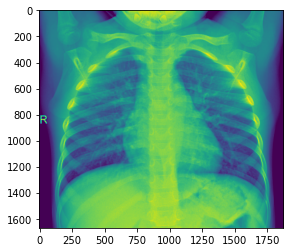

Predicted value
NORMAL2-IM-0818-0001.jpeg
Actual value


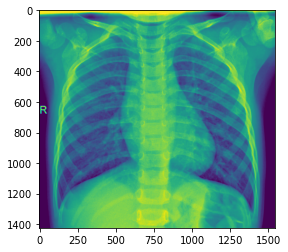

Predicted value
NORMAL2-IM-0563-0001.jpeg
Actual value


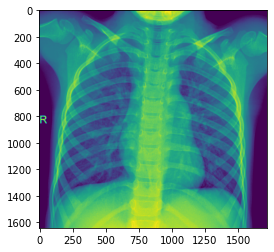

Predicted value
NORMAL2-IM-0907-0001.jpeg
Actual value


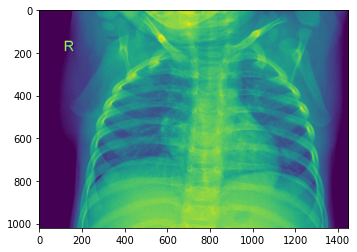

Predicted value
NORMAL2-IM-0826-0001.jpeg
Actual value


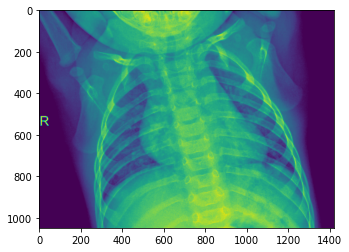

Predicted value
NORMAL2-IM-0634-0001.jpeg
Actual value


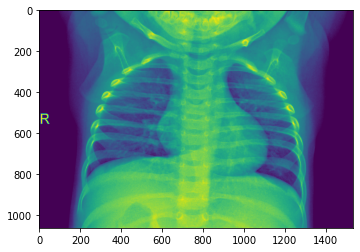

Predicted value
NORMAL2-IM-0869-0001.jpeg
Actual value


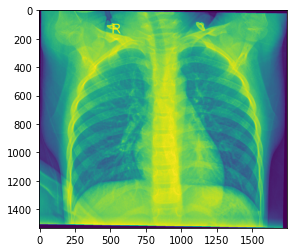

Predicted value
NORMAL2-IM-0890-0001.jpeg
Actual value


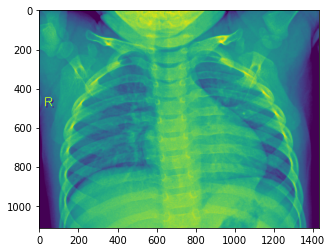

Predicted value
NORMAL2-IM-0914-0001.jpeg
Actual value


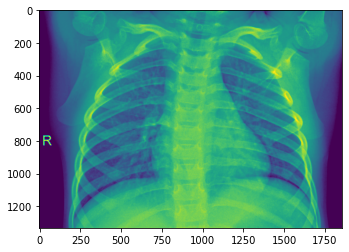

Predicted value
NORMAL2-IM-0799-0001.jpeg
Actual value


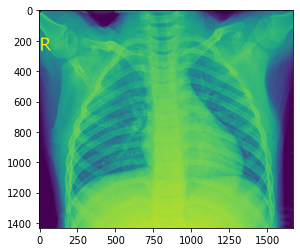

Predicted value
NORMAL2-IM-0727-0001.jpeg
Actual value


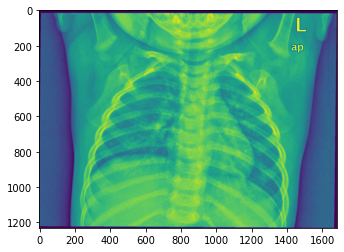

Predicted value
NORMAL2-IM-0651-0004.jpeg
Actual value


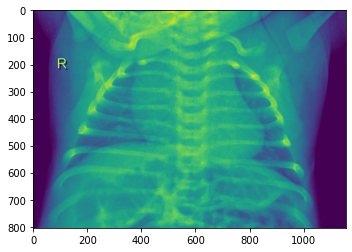

Predicted value
NORMAL2-IM-0872-0001.jpeg
Actual value


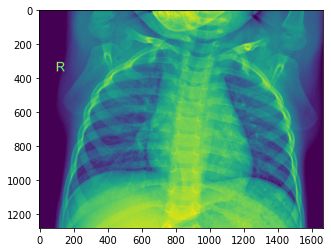

Predicted value
NORMAL2-IM-0633-0001.jpeg
Actual value


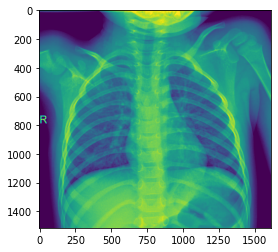

Predicted value
NORMAL2-IM-0797-0001.jpeg
Actual value


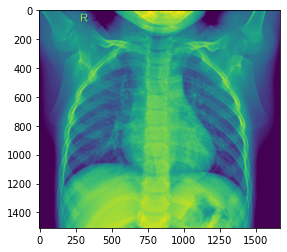

Predicted value
NORMAL2-IM-0836-0001.jpeg
Actual value


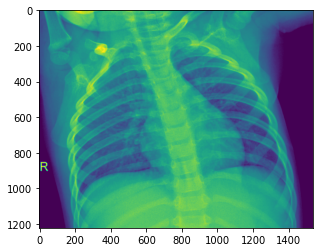

Predicted value
NORMAL2-IM-0683-0001.jpeg
Actual value


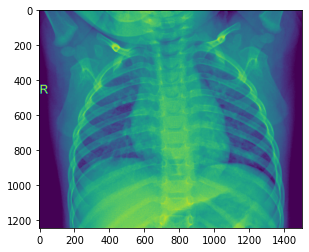

Predicted value
NORMAL2-IM-0687-0001.jpeg
Actual value


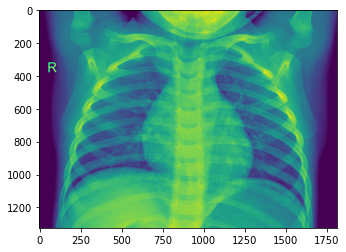

Predicted value
NORMAL2-IM-0557-0001.jpeg
Actual value


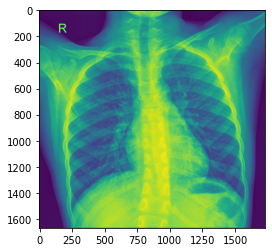

Predicted value
NORMAL2-IM-0551-0001.jpeg
Actual value


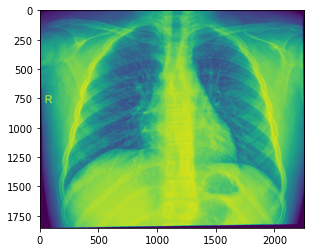

Predicted value
NORMAL2-IM-0911-0001.jpeg
Actual value


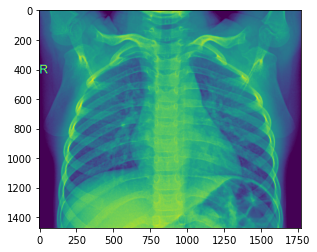

Predicted value
NORMAL2-IM-0863-0001.jpeg
Actual value


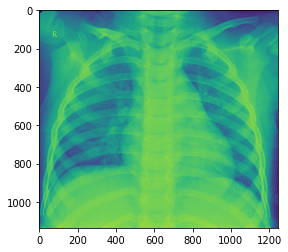

Predicted value
NORMAL2-IM-0718-0001.jpeg
Actual value


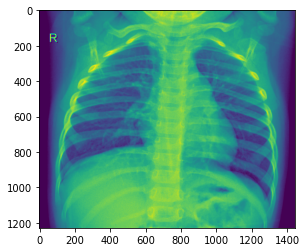

Predicted value
NORMAL2-IM-0851-0001.jpeg
Actual value


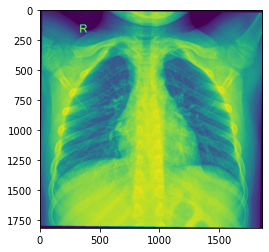

Predicted value
NORMAL2-IM-0684-0001-0001.jpeg
Actual value


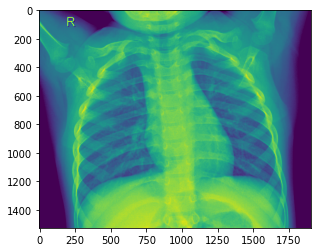

Predicted value
NORMAL2-IM-0859-0001.jpeg
Actual value


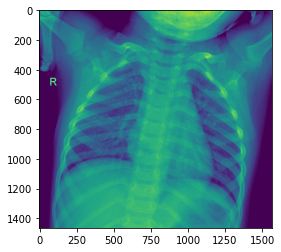

Predicted value
NORMAL2-IM-0619-0001.jpeg
Actual value


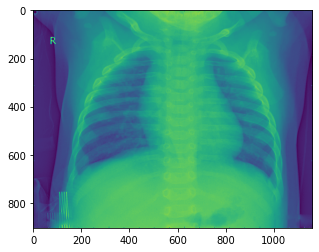

Predicted value
NORMAL2-IM-0757-0001.jpeg
Actual value


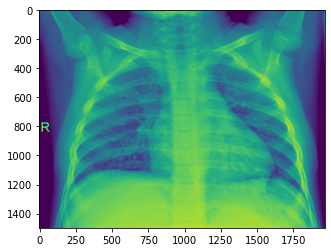

Predicted value
NORMAL2-IM-0653-0001.jpeg
Actual value


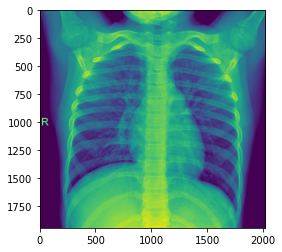

Predicted value
NORMAL2-IM-0892-0001.jpeg
Actual value


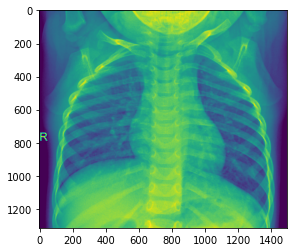

Predicted value
NORMAL2-IM-0596-0001.jpeg
Actual value


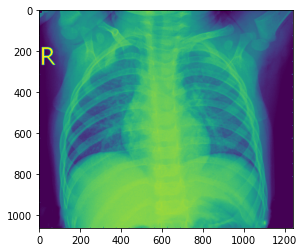

Predicted value
NORMAL2-IM-0741-0001.jpeg
Actual value


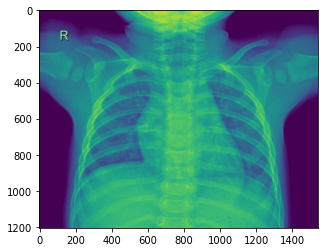

Predicted value
NORMAL2-IM-0671-0001.jpeg
Actual value


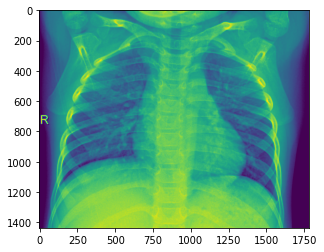

Predicted value
NORMAL2-IM-0851-0001-0002.jpeg
Actual value


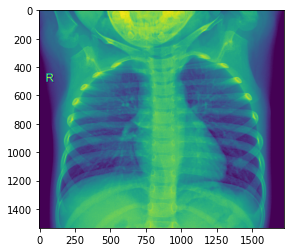

Predicted value
NORMAL2-IM-0692-0001.jpeg
Actual value


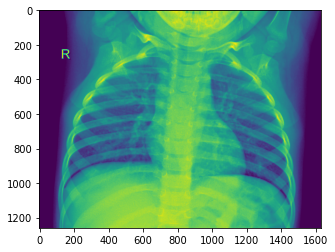

Predicted value
NORMAL2-IM-0871-0001.jpeg
Actual value


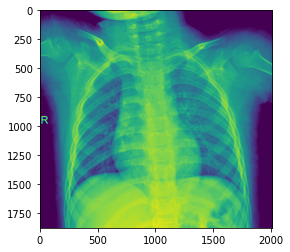

Predicted value
NORMAL2-IM-0545-0001.jpeg
Actual value


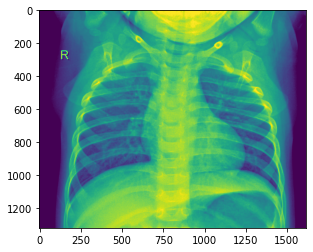

Predicted value
NORMAL2-IM-0673-0001.jpeg
Actual value


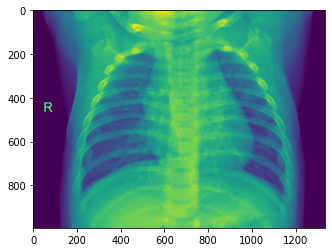

Predicted value
NORMAL2-IM-0867-0001.jpeg
Actual value


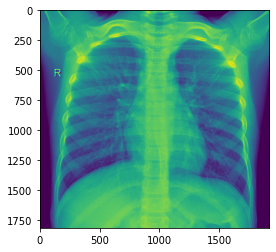

Predicted value
NORMAL2-IM-0641-0001.jpeg
Actual value


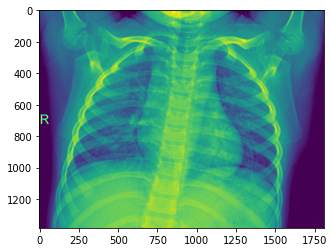

Predicted value
NORMAL2-IM-0894-0001.jpeg
Actual value


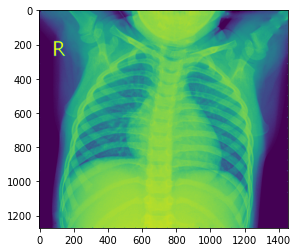

Predicted value
NORMAL2-IM-0746-0001.jpeg
Actual value


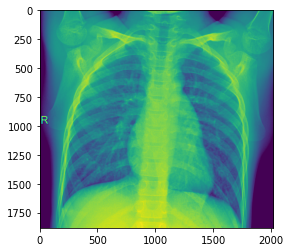

Predicted value
NORMAL2-IM-0694-0001.jpeg
Actual value


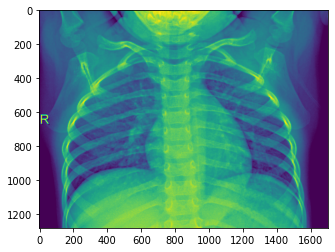

Predicted value
NORMAL2-IM-0849-0001.jpeg
Actual value


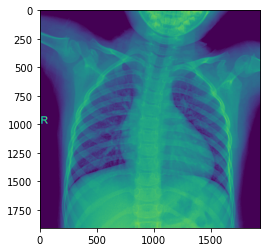

Predicted value
NORMAL2-IM-0808-0001.jpeg
Actual value


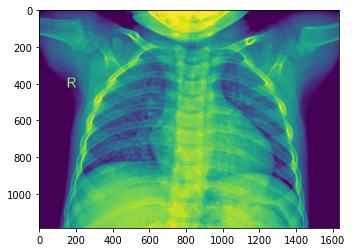

Predicted value
NORMAL2-IM-0832-0001-0001.jpeg
Actual value


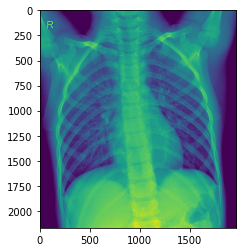

Predicted value
NORMAL2-IM-0567-0001.jpeg
Actual value


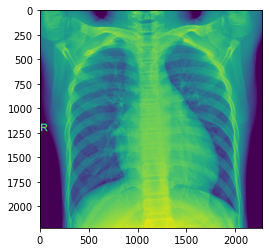

Predicted value
NORMAL2-IM-0781-0001.jpeg
Actual value


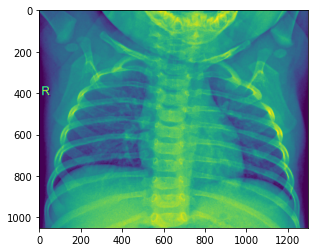

Predicted value
NORMAL2-IM-0838-0001.jpeg
Actual value


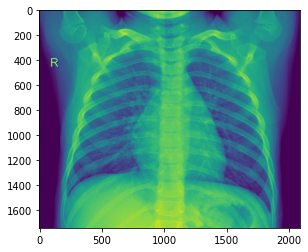

Predicted value
NORMAL2-IM-0882-0001.jpeg
Actual value


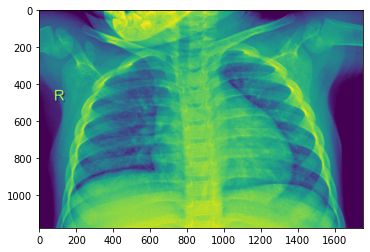

Predicted value
NORMAL2-IM-0910-0001.jpeg
Actual value


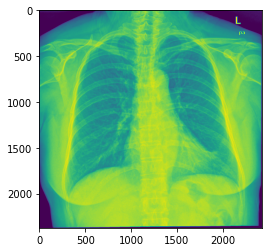

Predicted value
NORMAL2-IM-0899-0001.jpeg
Actual value


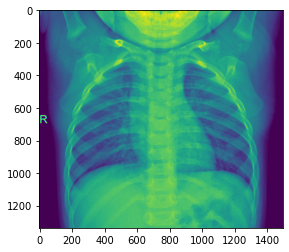

Predicted value
NORMAL2-IM-0807-0001.jpeg
Actual value


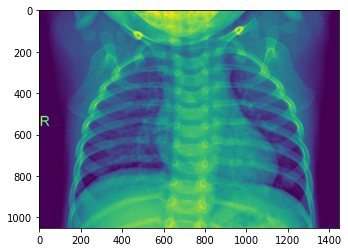

Predicted value
NORMAL2-IM-0798-0001.jpeg
Actual value


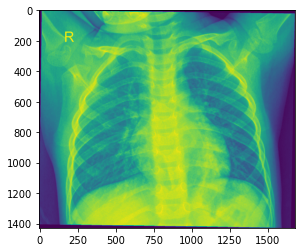

Predicted value
NORMAL2-IM-0855-0001.jpeg
Actual value


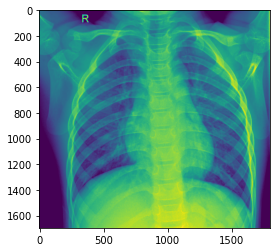

Predicted value
NORMAL2-IM-0568-0001.jpeg
Actual value


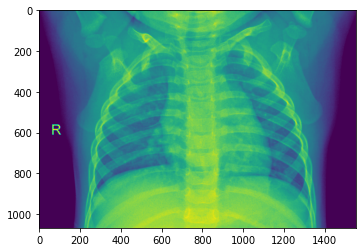

Predicted value
NORMAL2-IM-0815-0001.jpeg
Actual value


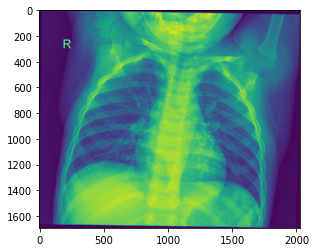

Predicted value
NORMAL2-IM-0834-0001.jpeg
Actual value


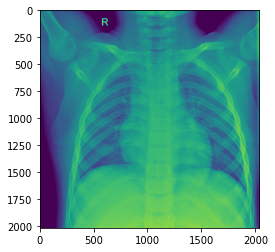

Predicted value
NORMAL2-IM-0831-0001.jpeg
Actual value


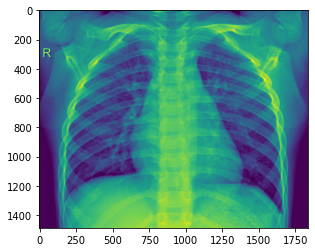

Predicted value
NORMAL2-IM-0821-0001.jpeg
Actual value


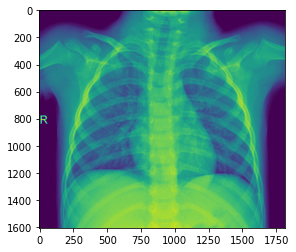

Predicted value
NORMAL2-IM-0886-0001.jpeg
Actual value


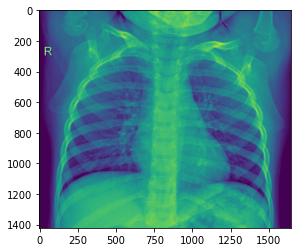

Predicted value
NORMAL2-IM-0816-0001.jpeg
Actual value


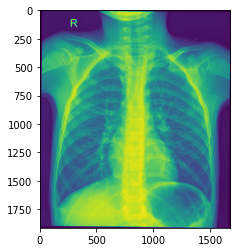

Predicted value
NORMAL2-IM-0818-0001-0002.jpeg
Actual value


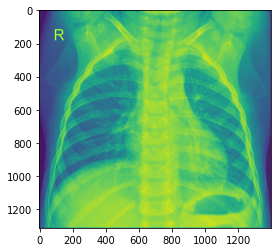

Predicted value
NORMAL2-IM-0856-0001.jpeg
Actual value


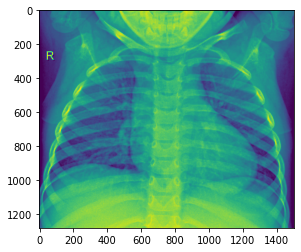

Predicted value
NORMAL2-IM-0868-0001.jpeg
Actual value


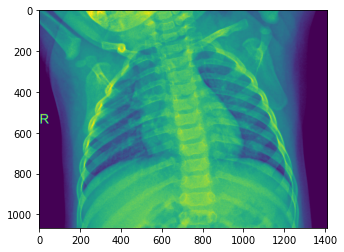

Predicted value
NORMAL2-IM-0749-0001.jpeg
Actual value


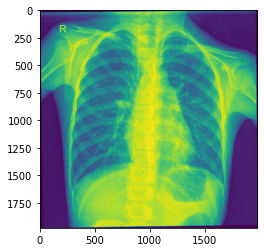

Predicted value
NORMAL2-IM-0621-0001.jpeg
Actual value


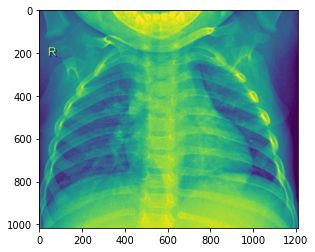

Predicted value
NORMAL2-IM-0873-0001.jpeg
Actual value


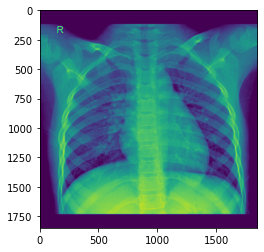

Predicted value
NORMAL2-IM-0585-0001.jpeg
Actual value


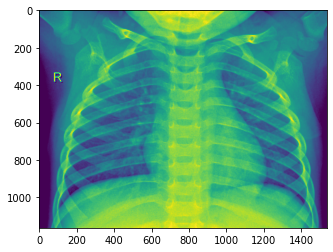

Predicted value
NORMAL2-IM-0832-0001.jpeg
Actual value


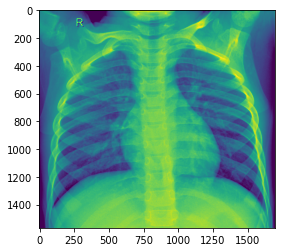

Predicted value
NORMAL2-IM-0573-0001.jpeg
Actual value


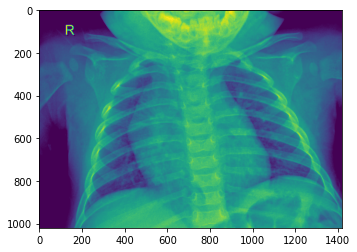

Predicted value
NORMAL2-IM-0662-0001.jpeg
Actual value


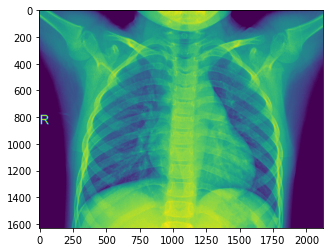

Predicted value
NORMAL2-IM-0571-0001.jpeg
Actual value


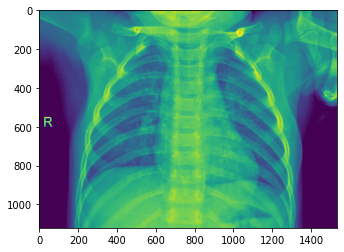

Predicted value
NORMAL2-IM-0618-0001.jpeg
Actual value


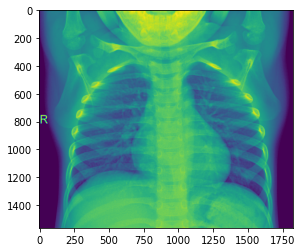

Predicted value
NORMAL2-IM-0906-0001.jpeg
Actual value


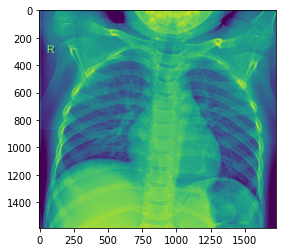

Predicted value
NORMAL2-IM-0580-0001.jpeg
Actual value


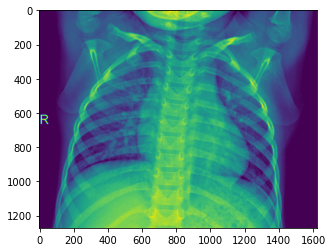

Predicted value
NORMAL2-IM-0589-0001.jpeg
Actual value


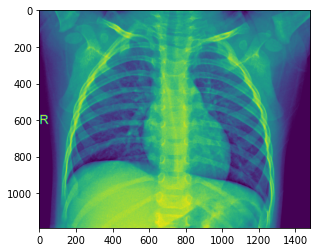

Predicted value
NORMAL2-IM-0582-0001.jpeg
Actual value


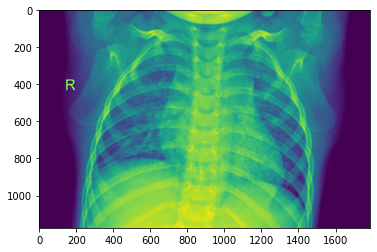

Predicted value
NORMAL2-IM-0840-0001.jpeg
Actual value


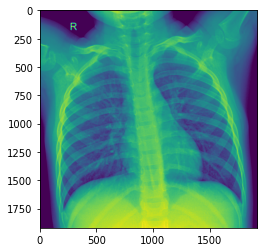

Predicted value
NORMAL2-IM-0699-0001.jpeg
Actual value


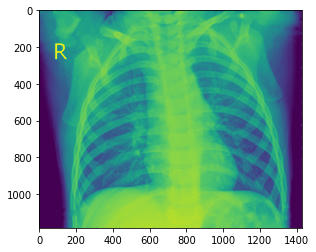

Predicted value
NORMAL2-IM-0736-0001.jpeg
Actual value


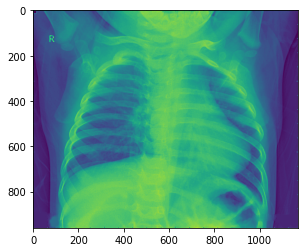

Predicted value
NORMAL2-IM-0723-0001.jpeg
Actual value


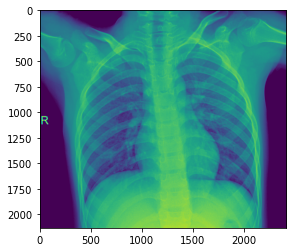

Predicted value
NORMAL2-IM-0555-0001-0002.jpeg
Actual value


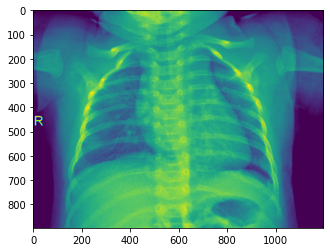

Predicted value
NORMAL2-IM-0690-0001.jpeg
Actual value


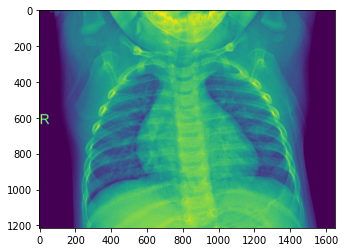

Predicted value
NORMAL2-IM-0561-0001.jpeg
Actual value


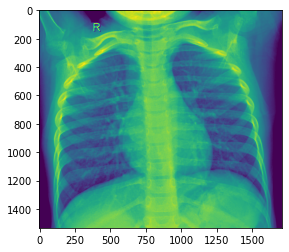

Predicted value
NORMAL2-IM-0583-0001.jpeg
Actual value


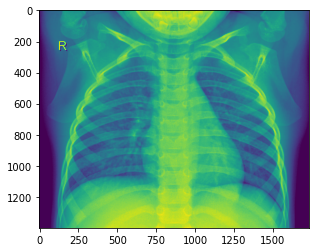

Predicted value
NORMAL2-IM-0814-0001.jpeg
Actual value


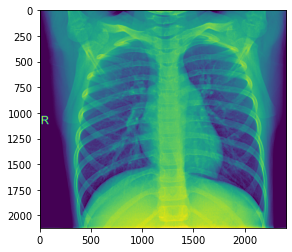

Predicted value
NORMAL2-IM-0627-0001.jpeg
Actual value


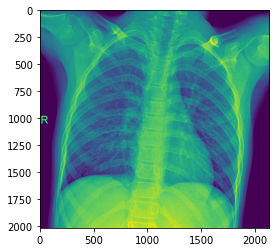

Predicted value
NORMAL2-IM-0841-0001.jpeg
Actual value


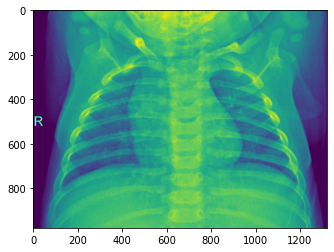

Predicted value
NORMAL2-IM-0809-0001.jpeg
Actual value


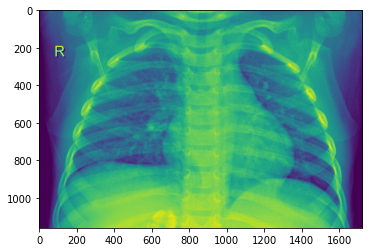

Predicted value
NORMAL2-IM-0569-0001.jpeg
Actual value


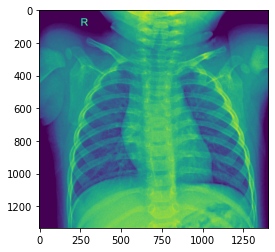

Predicted value
NORMAL2-IM-0550-0001.jpeg
Actual value


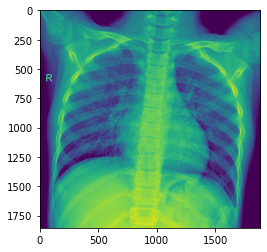

Predicted value
NORMAL2-IM-0839-0001.jpeg
Actual value


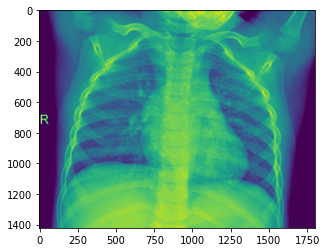

Predicted value
NORMAL2-IM-0696-0001.jpeg
Actual value


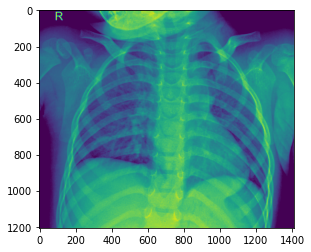

Predicted value
NORMAL2-IM-0866-0001.jpeg
Actual value


In [ ]:
from matplotlib import image
from matplotlib import pyplot

image_count=0

for i in os.listdir("./CovidDataset/Val/Normal/"):
  #img=image.load_img("./CovidDataset/Val/Normal/"+i, target_size=(224,224))
  image_test = image.imread("./CovidDataset/Val/Normal/"+i)
  pyplot.imshow(image_test)
  pyplot.show()
  print("Predicted value") 
  print(i)
  #print(y_test[image_count])
  print("Actual value")
  #print(y_actual[image_count])
  image_count = image_count + 1

In [ ]:
y_actual=np.array(y_actual)
y_test=np.array(y_test)

In [ ]:
from sklearn.metrics import confusion_matrix

In [ ]:
cm=confusion_matrix(y_actual, y_test)

In [ ]:
import seaborn as sns

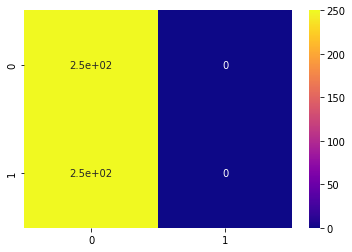

In [ ]:
sns.heatmap(cm, cmap="plasma", annot=True)

PLOT

In [ ]:
def plot_train_history(history, title):
  loss = history.history['loss']
  val_loss = history.history['val_loss']

  epochs = range(len(loss))

  plt.figure()

  plt.plot(epochs, loss, 'b', label='Training loss')
  plt.plot(epochs, val_loss, 'r', label='Validation loss')
  plt.title(title)
  plt.legend()

  plt.show()

In [ ]:
plot_train_history(hist, 'Training and validation loss')